In [13]:
import time
from datetime import datetime
import vectorbt as vbt

import pandas as pd
import pandas_ta as ta
import numpy as np
import mplfinance as mpf

import matplotlib.pyplot as plt

In [14]:
data = pd.read_csv('EURUSD_15m.csv')
data.tail()

,timestamp,open,high,low,close,adj close,volumn
15369,2022-06-30 16:45:00+01:00,1.046682,1.048438,1.046572,1.047120,1.047120,0
15370,2022-06-30 17:00:00+01:00,1.047120,1.047340,1.046463,1.046792,1.046792,0
15371,2022-06-30 17:15:00+01:00,1.046682,1.047779,1.046682,1.047669,1.047669,0
15372,2022-06-30 17:30:00+01:00,1.047889,1.048218,1.047230,1.047449,1.047449,0
15373,2022-06-30 17:45:00+01:00,1.047779,1.048878,1.047779,1.048438,1.048438,0


In [15]:
df = data.copy()
df['timestamp'] = pd.to_datetime(df['timestamp'], utc=True).dt.tz_localize(None)
df

,timestamp,open,high,low,close,adj close,volumn
0,2021-11-04 17:00:00,1.154734,1.155135,1.154734,1.155135,1.155135,0
1,2021-11-04 17:15:00,1.155135,1.155535,1.155001,1.155135,1.155135,0
2,2021-11-04 17:30:00,1.155001,1.155535,1.155001,1.155135,1.155135,0
3,2021-11-04 17:45:00,1.155001,1.155535,1.155001,1.155001,1.155001,0
4,2021-11-04 18:00:00,1.155135,1.155535,1.155135,1.155535,1.155535,0
...,...,...,...,...,...,...,...
15369,2022-06-30 15:45:00,1.046682,1.048438,1.046572,1.047120,1.047120,0
15370,2022-06-30 16:00:00,1.047120,1.047340,1.046463,1.046792,1.046792,0
15371,2022-06-30 16:15:00,1.046682,1.047779,1.046682,1.047669,1.047669,0
15372,2022-06-30 16:30:00,1.047889,1.048218,1.047230,1.047449,1.047449,0


In [6]:
rsi_supertrend = ta.Strategy(
    name = 'RSI and Supertrend',
    description = 'RSI and Supertrend',
    ta = [
        {'kind': 'supertrend', 'length': 7}, # 'multiplier': 3.0},
        {'kind': 'rsi', 'length': 14},
        {'kind': 'atr', 'length': 14}
    ]
)
df.ta.strategy(rsi_supertrend)
df

,timestamp,open,high,low,close,adj close,volumn,SUPERT_7_3.0,SUPERTd_7_3.0,SUPERTl_7_3.0,SUPERTs_7_3.0,RSI_14,ATRr_14
0,2021-11-04 17:00:00,1.154734,1.155135,1.154734,1.155135,1.155135,0,0.000000,1,NaN,NaN,NaN,NaN
1,2021-11-04 17:15:00,1.155135,1.155535,1.155001,1.155135,1.155135,0,NaN,1,NaN,NaN,NaN,NaN
2,2021-11-04 17:30:00,1.155001,1.155535,1.155001,1.155135,1.155135,0,NaN,1,NaN,NaN,NaN,NaN
3,2021-11-04 17:45:00,1.155001,1.155535,1.155001,1.155001,1.155001,0,NaN,1,NaN,NaN,NaN,NaN
4,2021-11-04 18:00:00,1.155135,1.155535,1.155135,1.155535,1.155535,0,NaN,1,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...
15369,2022-06-30 15:45:00,1.046682,1.048438,1.046572,1.047120,1.047120,0,1.042831,1,1.042831,NaN,69.455336,0.001367
15370,2022-06-30 16:00:00,1.047120,1.047340,1.046463,1.046792,1.046792,0,1.042831,1,1.042831,NaN,67.161708,0.001332
15371,2022-06-30 16:15:00,1.046682,1.047779,1.046682,1.047669,1.047669,0,1.043004,1,1.043004,NaN,70.007127,0.001315
15372,2022-06-30 16:30:00,1.047889,1.048218,1.047230,1.047449,1.047449,0,1.043678,1,1.043678,NaN,68.410336,0.001292


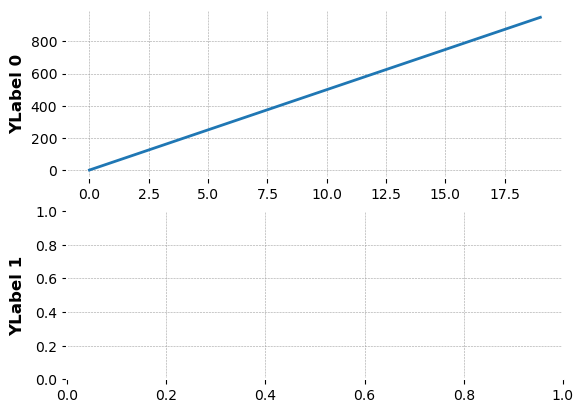

In [22]:
fig, axs = plt.subplots(2, 1)
axs[0].plot(np.arange(0, 1000, 50))
axs[0].set_ylabel('YLabel 0')
axs[1].set_ylabel('YLabel 1')
fig.align_ylabels()

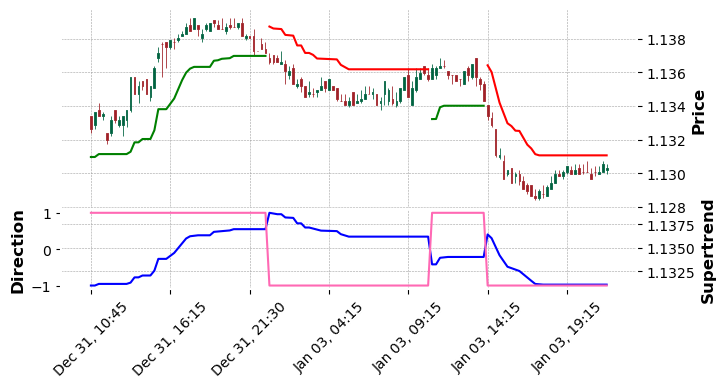

In [40]:
data_test = df.copy()
data_test.set_index('timestamp', inplace = True)

superT1 = data_test['SUPERT_7_3.0'].loc['2021-12-31 10:45:00': '2022-01-03 21:45:00']
superT2= data_test['SUPERTd_7_3.0'].loc['2021-12-31 10:45:00': '2022-01-03 21:45:00']
superT3 = data_test['SUPERTl_7_3.0'].loc['2021-12-31 10:45:00': '2022-01-03 21:45:00']
superT4 = data_test['SUPERTs_7_3.0'].loc['2021-12-31 10:45:00': '2022-01-03 21:45:00']

data_test_plot = data_test.loc['2021-12-31 10:45:00': '2022-01-03 21:45:00']

superT1_plot = mpf.make_addplot(superT1, panel=1, color='blue', width=1.5, ylabel='Supertrend')
superT2_plot = mpf.make_addplot(superT2, panel=1, color='hotpink', width=1.5, ylabel='Direction')
superT3_plot = mpf.make_addplot(superT3, panel=0, color='green', width=1.5, ylabel='Long')
superT4_plot = mpf.make_addplot(superT4, panel=0, color='red', width=1.5, ylabel='Short')

mpf.plot(data_test_plot, 
         type='candle', style='charles',
         addplot=[
             superT1_plot, 
             superT2_plot,
             superT3_plot,
             superT4_plot
         ],
         figsize=(8, 4))

In [44]:
df[df['SUPERTd_7_3.0'] == 0]

,timestamp,open,high,low,close,adj close,volumn,SUPERT_7_3.0,SUPERTd_7_3.0,SUPERTl_7_3.0,SUPERTs_7_3.0,RSI_14,ATRr_14


In [16]:
class RSI_and_Supertrend:
    def __init__(self, params):
        
        self.current_action = 'close'
        self.atr = params['atr']
        self.supertrend = params['supertrend']
        self.rsi = params['rsi']
        
        self.overbought = params['overbought']
        self.oversold = params['oversold']
        self.rr = params['rr']
        
        self.df = params['df']
        self.pip = params['pip']
        self.pip_value = params['pip_value']
        self.target_tp = params['target_tp']
        
        self.latest_sl = 0
        self.latest_tp = 0
        
    def get_df(self):
        return self.df
    
    def calLotSize(self, entry, exit):
        return abs(round(self.target_tp / (entry - exit)  , 2))
#         return abs(round(self.target_tp / (((entry - exit) / self.pip ) * self.pip_value ) , 2))
        
    def createLongOrders(self, row):
        if self.current_action == 'close':
            if row['SUPERTd_'+str(self.supertrend)+'_3.0'] == 1 and row['RSI_'+str(self.rsi)] > self.overbought and \
                    row['prev_rsi'] < self.overbought:
                
                row['entries'] = True
                self.current_action = 'long'
                
                self.latest_sl = row['low'] - row['ATRr_'+str(self.atr)]
                self.latest_tp = row['open'] + (self.rr * abs(row['open'] - self.latest_sl))
                row['lot_size'] = self.calLotSize(row['open'], self.latest_tp)
        
        else:
            if row['low'] <= self.latest_sl:
                    self.current_action = 'close'
                    row['exits'] = True
                    row['price_action'] = self.latest_sl
                    row['lot_size'] = 0
                    
            elif row['high'] >= self.latest_tp:
                    self.current_action = 'close'
                    row['exits'] = True
                    row['price_action'] = self.latest_tp
                    row['lot_size'] = 0
        
        return row
    
    def createShortOrders(self, row):
        if self.current_action == 'close':
            if row['SUPERTd_'+str(self.supertrend)+'_3.0'] == -1 and row['RSI_'+str(self.rsi)] < self.oversold and \
                    row['prev_rsi'] > self.oversold:
                    
                row['short_entries'] = True
                self.current_action = 'short'
                
                self.latest_sl = row['high'] + row['ATRr_'+str(self.atr)]
                self.latest_tp = row['open'] - (self.rr * abs(row['open'] - self.latest_sl))
                row['lot_size'] = self.calLotSize(row['open'], self.latest_tp)
    
        else:
            if row['high'] >= self.latest_sl:
                    self.current_action = 'close'
                    row['short_exits'] = True
                    row['price_action'] = self.latest_sl
                    row['lot_size'] = 0
                    
            elif row['low'] <= self.latest_tp:
                    self.current_action = 'close'
                    row['short_exits'] = True
                    row['price_action'] = self.latest_tp
                    row['lot_size'] = 0
                    
        return row
                    
    def createStrategy(self):
        rsi_supertrend = ta.Strategy(
            name = 'RSI and Supertrend',
            description = 'RSI and Supertrend',
            ta = [
                {'kind': 'supertrend', 'length': self.supertrend},
                {'kind': 'rsi', 'length': self.rsi},
                {'kind': 'atr', 'length': self.atr}
            ]
        )
        self.df.ta.strategy(rsi_supertrend)
        
        self.df['timestamp'] = pd.to_datetime(self.df['timestamp'])
        self.df['entries'] = False
        self.df['exits'] = False
        
        self.df['short_entries'] = False
        self.df['short_exits'] = False
        self.df['price_action'] = self.df['open']
        
        self.df['prev_rsi'] = self.df['RSI_'+str(self.rsi)].shift(1)
        self.df['lot_size'] = np.nan
        
    def getLongOrders(self):
        self.createStrategy()
        self.df = self.df.apply(lambda row : self.createLongOrders(row), axis=1)
                                                                
        return self.df
    
    def getShortOrders(self):
        self.createStrategy()
        self.df = self.df.apply(lambda row : self.createShortOrders(row), axis=1)
                                                                
        return self.df
        

In [17]:
pair_test = RSI_and_Supertrend({
    'atr': 17,
    'rsi': 10,
    'supertrend': 35,
    'overbought': 73,
    'oversold': 27,
    'pip': 0.0001,
    'pip_value': 10,
    'rr': 1.5,
    'target_tp': 10,
    'df': df.copy()
})
result_long = pair_test.getLongOrders().set_index('timestamp')
result_short = pair_test.getShortOrders().set_index('timestamp')
result_long

,open,high,low,close,adj close,volumn,SUPERT_35_3.0,SUPERTd_35_3.0,SUPERTl_35_3.0,SUPERTs_35_3.0,RSI_10,ATRr_17,entries,exits,short_entries,short_exits,price_action,prev_rsi,lot_size
timestamp,,,,,,,,,,,,,,,,,,,
2021-11-04 17:00:00,1.154734,1.155135,1.154734,1.155135,1.155135,0,0.000000,1,NaN,NaN,NaN,NaN,False,False,False,False,1.154734,NaN,NaN
2021-11-04 17:15:00,1.155135,1.155535,1.155001,1.155135,1.155135,0,NaN,1,NaN,NaN,NaN,NaN,False,False,False,False,1.155135,NaN,NaN
2021-11-04 17:30:00,1.155001,1.155535,1.155001,1.155135,1.155135,0,NaN,1,NaN,NaN,NaN,NaN,False,False,False,False,1.155001,NaN,NaN
2021-11-04 17:45:00,1.155001,1.155535,1.155001,1.155001,1.155001,0,NaN,1,NaN,NaN,NaN,NaN,False,False,False,False,1.155001,NaN,NaN
2021-11-04 18:00:00,1.155135,1.155535,1.155135,1.155535,1.155535,0,NaN,1,NaN,NaN,NaN,NaN,False,False,False,False,1.155135,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-06-30 15:45:00,1.046682,1.048438,1.046572,1.047120,1.047120,0,1.044252,1,1.044252,NaN,75.395561,0.001306,False,True,False,False,1.046944,73.088004,0.00
2022-06-30 16:00:00,1.047120,1.047340,1.046463,1.046792,1.046792,0,1.044252,1,1.044252,NaN,71.966149,0.001281,False,False,False,False,1.047120,75.395561,NaN
2022-06-30 16:15:00,1.046682,1.047779,1.046682,1.047669,1.047669,0,1.044252,1,1.044252,NaN,75.296675,0.001270,True,False,False,False,1.046682,71.966149,5247.93


In [50]:
port = vbt.Portfolio.from_signals(result_long.price_action,
                                  entries=result_long.entries.astype('bool'),
                                  exits=result_long.exits.astype('bool'),
#                                   short_entries=result_short.short_entries.astype('bool'),
#                                   short_exits=result_short.short_exits.astype('bool'),
                                  size=result_long.lot_size, 
                                  freq="15m",
                                  init_cash=20000,
#                                   fees=0.0005, 
                                  slippage=0.0002
                                 )

In [51]:
port.plot().show()

<AxesSubplot:xlabel='timestamp'>

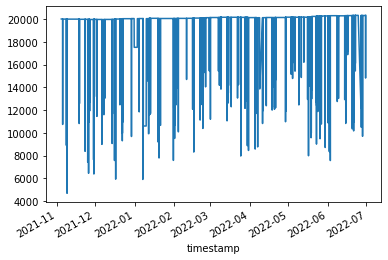

In [52]:
port.cash().plot()

In [53]:
port.stats()

Start                               2021-11-04 17:00:00
End                                 2022-06-30 16:45:00
Period                                160 days 03:30:00
Start Value                                     20000.0
End Value                                  20319.176819
Total Return [%]                               1.595884
Benchmark Return [%]                          -9.192318
Max Gross Exposure [%]                        76.586633
Total Fees Paid                                     0.0
Max Drawdown [%]                               0.308652
Max Drawdown Duration                  37 days 06:30:00
Total Trades                                        180
Total Closed Trades                                 180
Total Open Trades                                     0
Open Trade PnL                                      0.0
Win Rate [%]                                       70.0
Best Trade [%]                                 0.643132
Worst Trade [%]                               -0

In [46]:
port2 = vbt.Portfolio.from_signals(result_short.price_action,
#                                   entries=result_long.entries.astype('bool'),
#                                   exits=result_long.exits.astype('bool'),
                                  short_entries=result_short.short_entries.astype('bool'),
                                  short_exits=result_short.short_exits.astype('bool'),
#                                   direaction='shortonly',
                                  size=result_short.lot_size,
                                  size_type=0,
                                  freq="15m",
                                  init_cash=20000,
#                                   fees=0.0005, 
                                  slippage=0.0002
                                 )

In [47]:
port2.plot().show()

<AxesSubplot:xlabel='timestamp'>

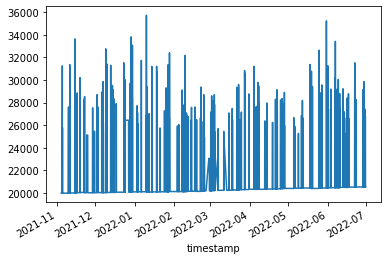

In [48]:
port2.cash().plot()

In [49]:
port2.stats()

Start                               2021-11-04 17:00:00
End                                 2022-06-30 16:45:00
Period                                160 days 03:30:00
Start Value                                     20000.0
End Value                                   20561.10505
Total Return [%]                               2.805525
Benchmark Return [%]                          -9.262359
Max Gross Exposure [%]                      4844.841821
Total Fees Paid                                     0.0
Max Drawdown [%]                                0.22376
Max Drawdown Duration                   9 days 12:30:00
Total Trades                                        216
Total Closed Trades                                 216
Total Open Trades                                     0
Open Trade PnL                                      0.0
Win Rate [%]                                  74.074074
Best Trade [%]                                 0.303065
Worst Trade [%]                               -0